## Import Modules

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

## Load the files

In [ ]:
BASE_DIR = '/kaggle/input/anime-faces/data/'

In [ ]:
!pip install opendatasets --upgrade --quiet

In [ ]:
import opendatasets as od

dataset_url = 'https://www.kaggle.com/datasets/soumikrakshit/anime-faces'
od.download(dataset_url)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: abishekfranklin
Your Kaggle Key: ··········


100%|██████████| 441M/441M [00:03<00:00, 137MB/s]


In [ ]:
import os

BASE_DIR = './anime-faces/data'
print(os.listdir(BASE_DIR))

['2215.png', '20218.png', '16232.png', '21134.png', '1303.png', '4605.png', '9966.png', '7308.png', '21409.png', '5718.png', '7446.png', '5022.png', '8252.png', '5131.png', '2415.png', '10175.png', '2957.png', '13569.png', '7096.png', '11158.png', '16689.png', '18447.png', '2721.png', '20736.png', '2065.png', '20531.png', '16028.png', '18248.png', '18666.png', '13109.png', '3452.png', '6998.png', '21494.png', '666.png', '998.png', '9994.png', '1202.png', '5511.png', '7610.png', '11199.png', '9910.png', '12434.png', '7030.png', '15225.png', '19899.png', '17657.png', '109.png', '19916.png', '18852.png', '9758.png', '18573.png', '19044.png', '2305.png', '21530.png', '21155.png', '7794.png', '8934.png', '3789.png', '15920.png', '16117.png', '11163.png', '16848.png', '21160.png', '19996.png', '15690.png', '17061.png', '6146.png', '11417.png', '19110.png', '5313.png', '12234.png', '8041.png', '1317.png', '9366.png', '19565.png', '3961.png', '15236.png', '5093.png', '4527.png', '18711.png', '

In [ ]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [ ]:
image_paths[:5]

['./anime-faces/data/2215.png',
 './anime-faces/data/20218.png',
 './anime-faces/data/16232.png',
 './anime-faces/data/21134.png',
 './anime-faces/data/1303.png']

In [ ]:
# remove unnecessary file
image_paths.remove('./anime-faces/data/data')

In [ ]:
len(image_paths)

21551

## Visualize the Image Dataset

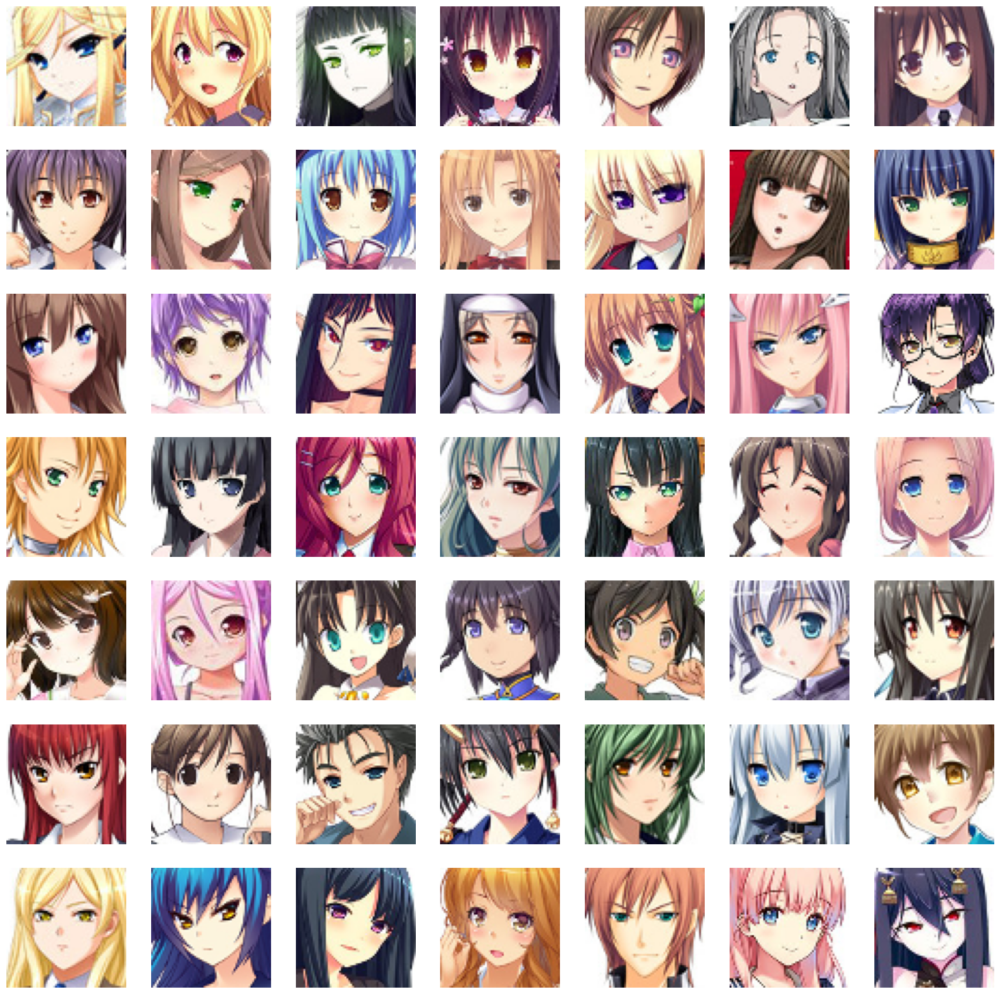

In [ ]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

## Preprocess Images

In [ ]:
# load the image and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [ ]:
train_images[0].shape

(64, 64, 3)

In [ ]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [ ]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [ ]:
train_images[0]

array([[[0.99215686, 0.9843137 , 0.96862745],
        [0.9843137 , 1.        , 0.92941177],
        [0.94509804, 0.9843137 , 0.94509804],
        ...,
        [0.9372549 , 0.8352941 , 0.33333334],
        [0.96862745, 0.9137255 , 0.5137255 ],
        [1.        , 1.        , 0.5921569 ]],

       [[0.96862745, 0.99215686, 0.88235295],
        [0.8980392 , 0.94509804, 1.        ],
        [0.9372549 , 1.        , 0.9372549 ],
        ...,
        [0.99215686, 0.77254903, 0.1764706 ],
        [0.9843137 , 0.79607844, 0.19215687],
        [0.96862745, 0.99215686, 0.60784316]],

       [[0.94509804, 0.94509804, 0.9137255 ],
        [0.96862745, 1.        , 0.99215686],
        [0.92156863, 0.92156863, 0.9137255 ],
        ...,
        [1.        , 0.7882353 , 0.23137255],
        [0.94509804, 0.75686276, 0.22352941],
        [0.92156863, 0.8666667 , 0.41960785]],

       ...,

       [[1.        , 0.99215686, 1.        ],
        [0.9843137 , 0.9607843 , 0.92941177],
        [0.99215686, 1

## Create Generator & Discriminator Models

In [ ]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

### Generator Model

Generator Model will create new images similar to training data from random noise

In [ ]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
# model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 16, 16, 256)       2097408   
 anspose)                                                        
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 32, 32, 128)       524416    
 Transpose)                                              

### Discriminator Model

Discriminator model will classify the image from the generator to check whether it real (or) fake images.

In [ ]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization_3 (Bat  (None, 32, 32, 64)        256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_5 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_4 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 16, 16, 128)     

## Create DCGAN

In [ ]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [ ]:
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [ ]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/50
674/674 [==============================] - ETA: 0s - d_loss: 0.5837 - g_loss: 2.8186

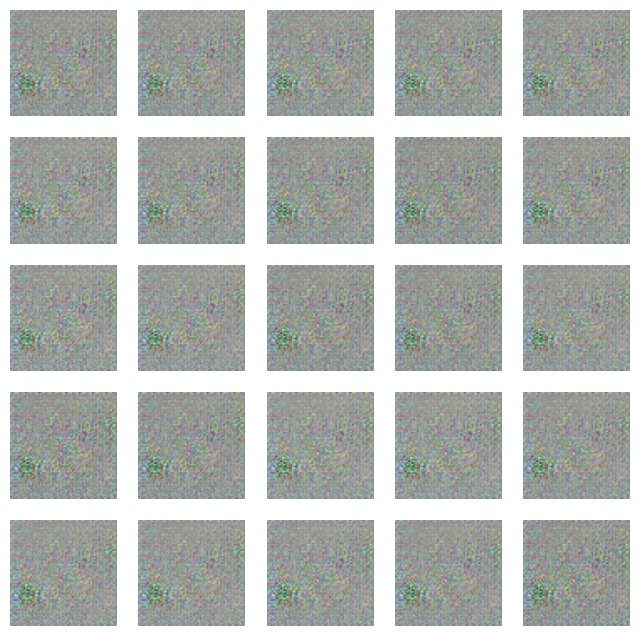

674/674 [==============================] - 53s 65ms/step - d_loss: 0.5837 - g_loss: 2.8186
Epoch 2/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.4263 - g_loss: 2.3710

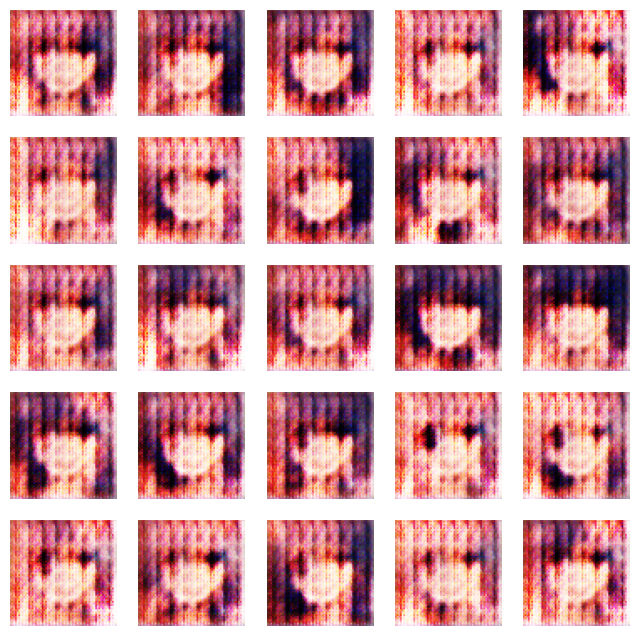

674/674 [==============================] - 45s 67ms/step - d_loss: 0.4265 - g_loss: 2.3709
Epoch 3/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5952 - g_loss: 1.7286

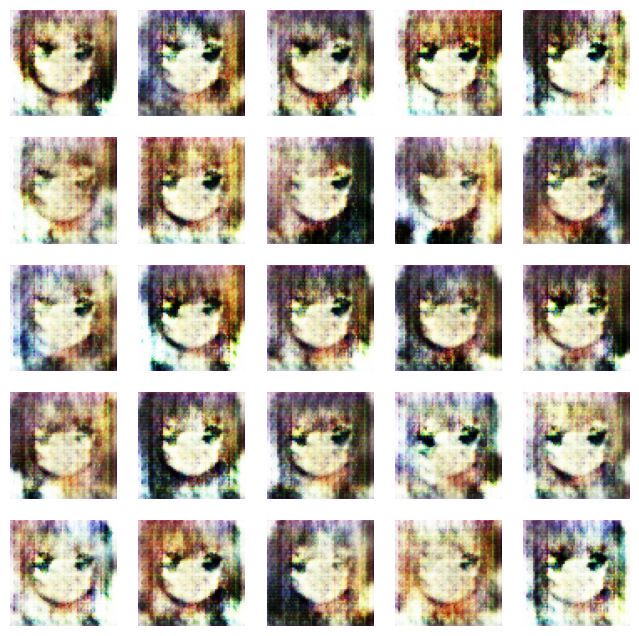

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5951 - g_loss: 1.7295
Epoch 4/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5623 - g_loss: 1.8648

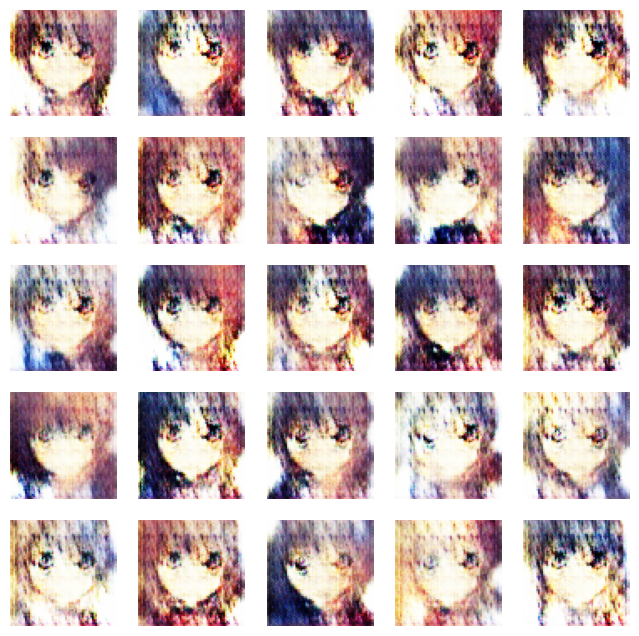

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5621 - g_loss: 1.8651
Epoch 5/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5804 - g_loss: 1.7619

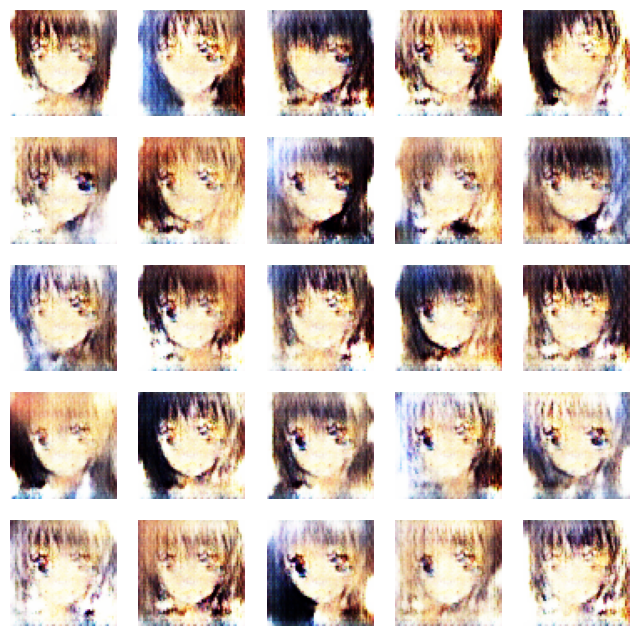

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5802 - g_loss: 1.7617
Epoch 6/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5607 - g_loss: 1.7782

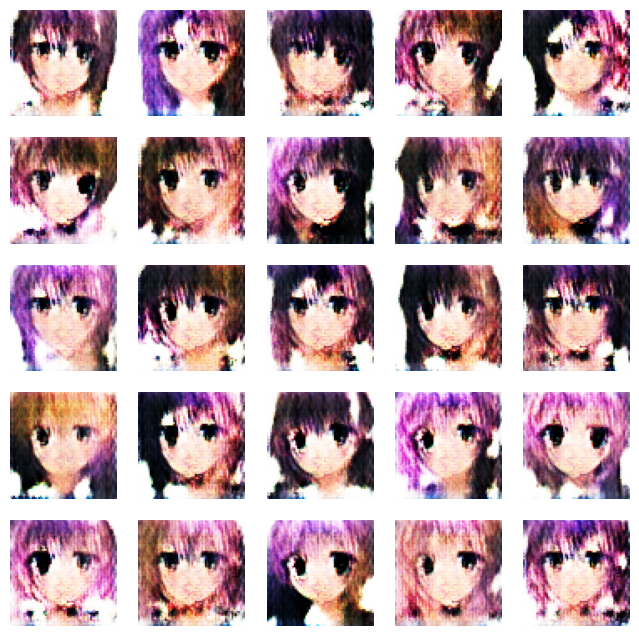

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5609 - g_loss: 1.7776
Epoch 7/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5659 - g_loss: 1.6824

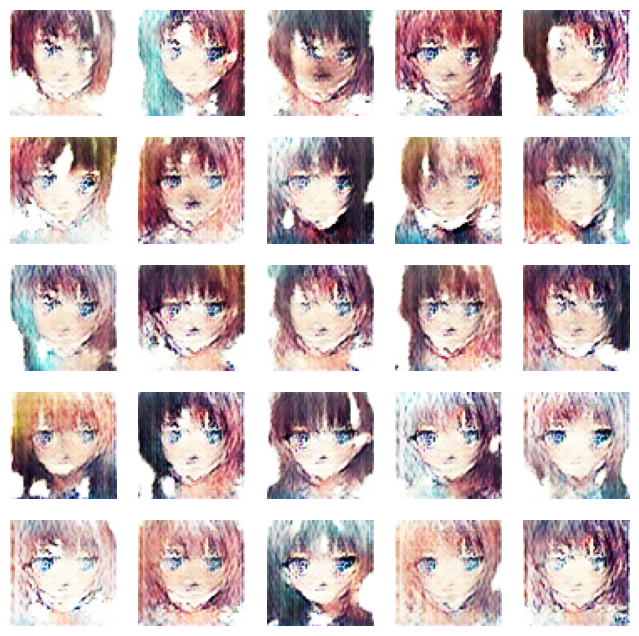

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5661 - g_loss: 1.6818
Epoch 8/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5645 - g_loss: 1.5802

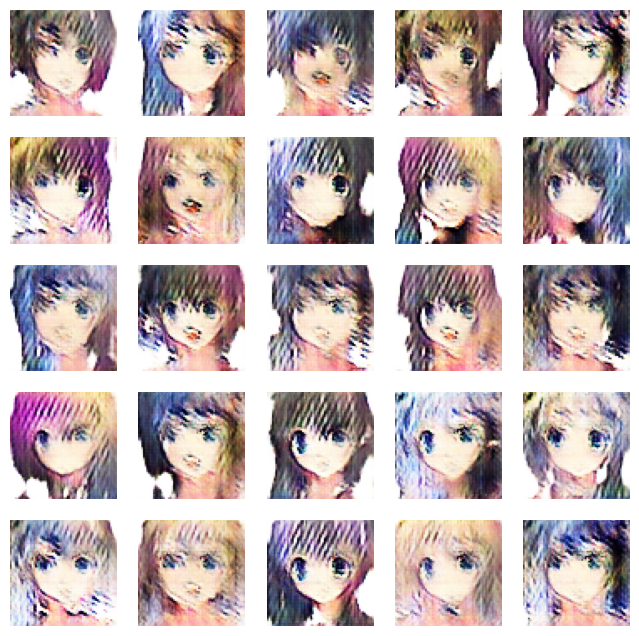

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5647 - g_loss: 1.5793
Epoch 9/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5365 - g_loss: 1.6465

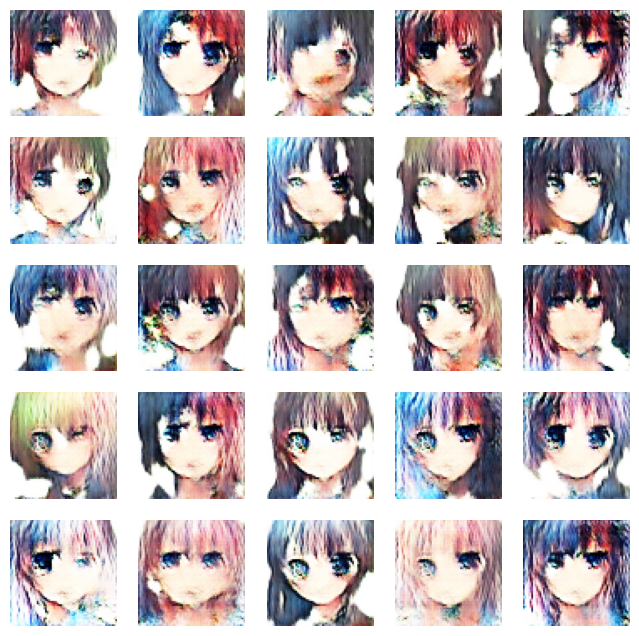

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5364 - g_loss: 1.6470
Epoch 10/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5305 - g_loss: 1.7272

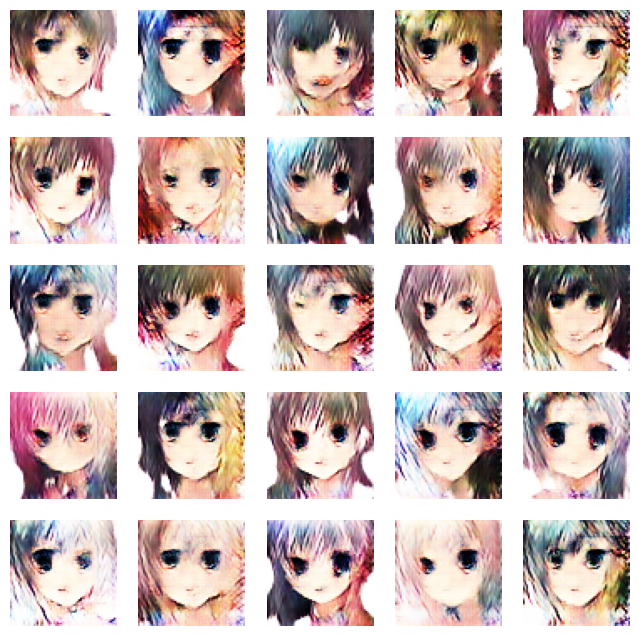

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5306 - g_loss: 1.7272
Epoch 11/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5384 - g_loss: 1.6562

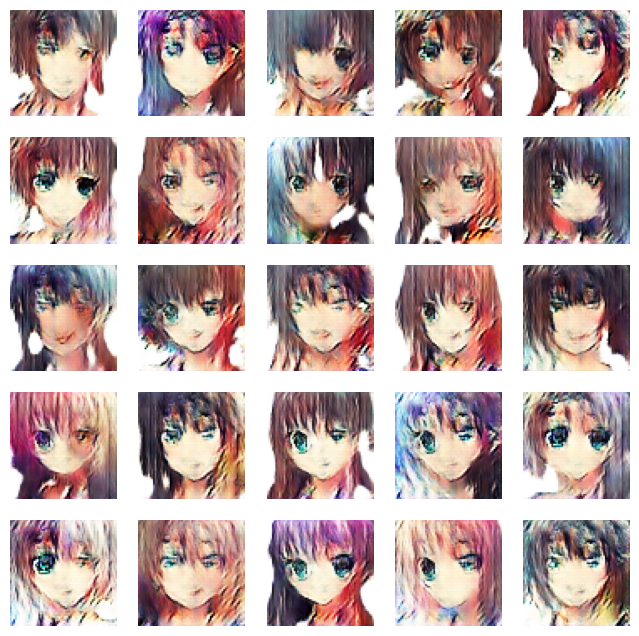

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5386 - g_loss: 1.6571
Epoch 12/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5808 - g_loss: 1.4120

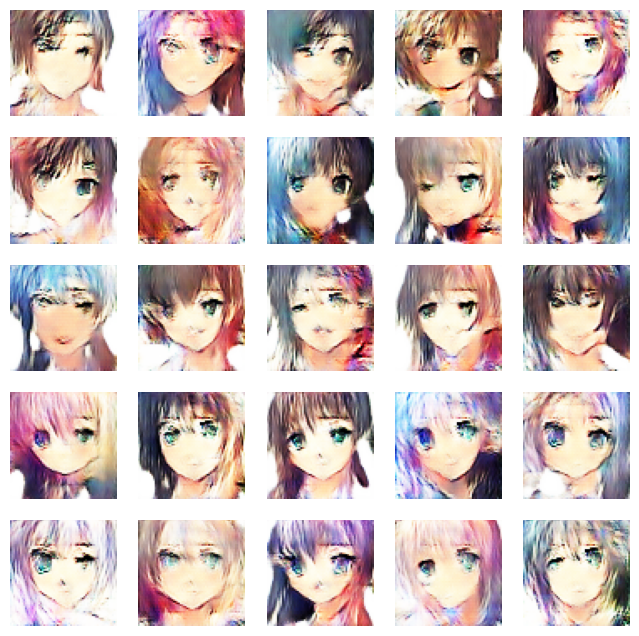

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5806 - g_loss: 1.4124
Epoch 13/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6090 - g_loss: 1.2499

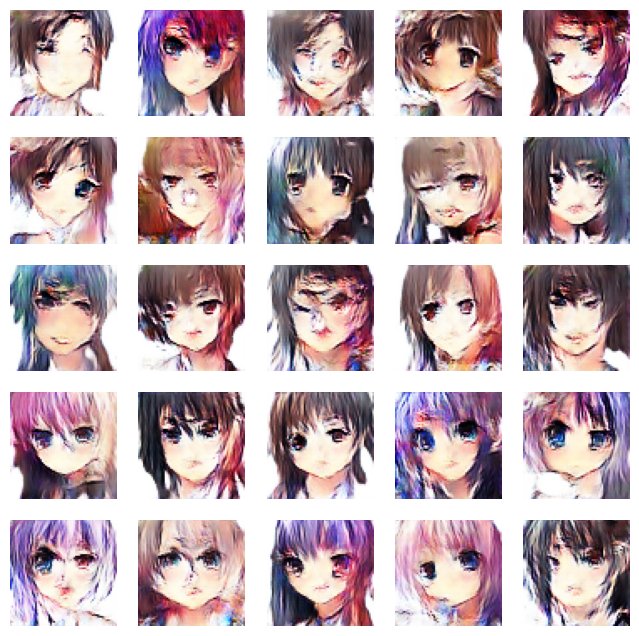

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6087 - g_loss: 1.2502
Epoch 14/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6189 - g_loss: 1.2067

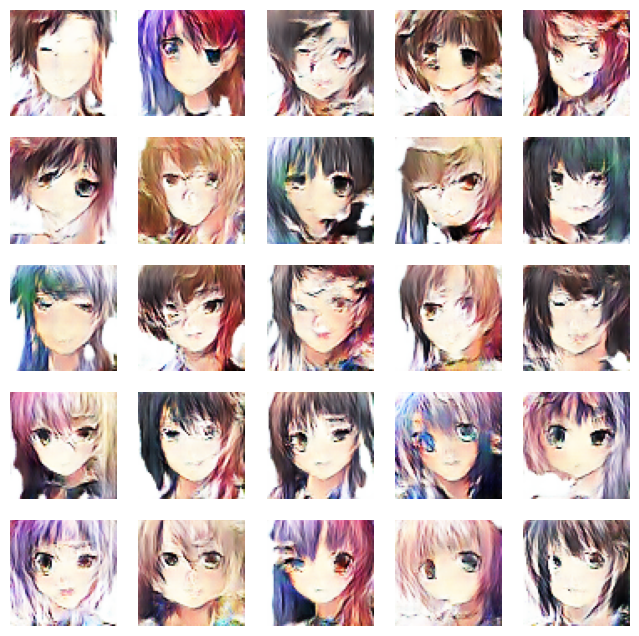

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6191 - g_loss: 1.2064
Epoch 15/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6290 - g_loss: 1.1546

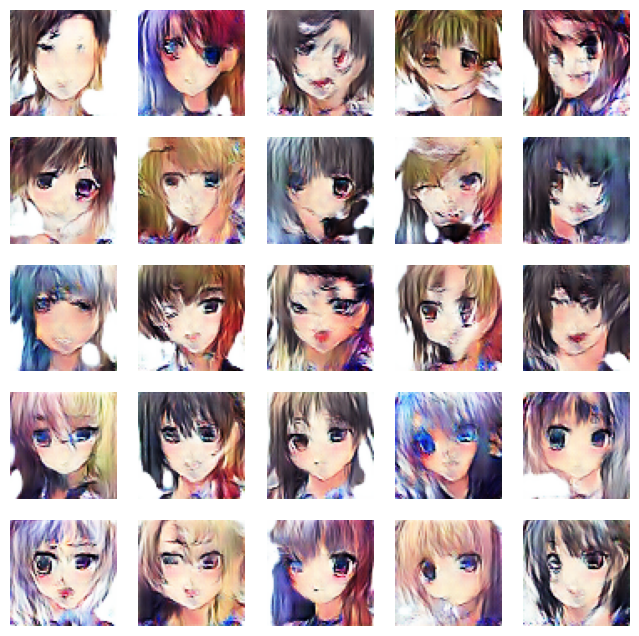

674/674 [==============================] - 44s 66ms/step - d_loss: 0.6290 - g_loss: 1.1550
Epoch 16/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6424 - g_loss: 1.1103

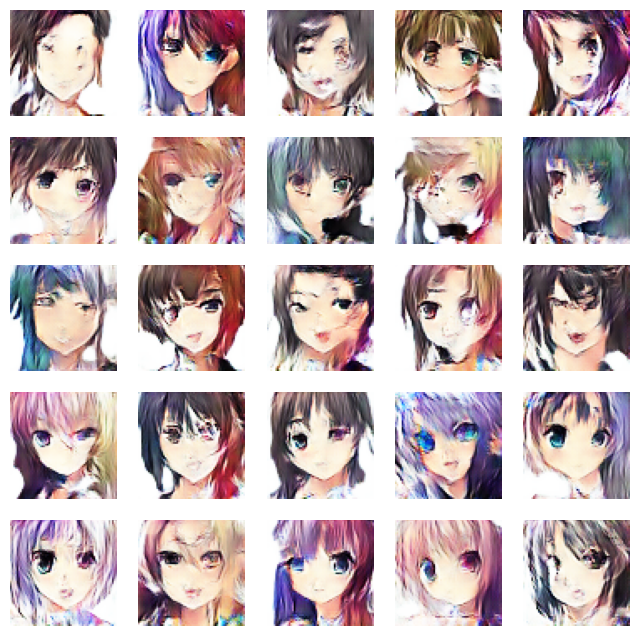

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6426 - g_loss: 1.1100
Epoch 17/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6536 - g_loss: 1.0737

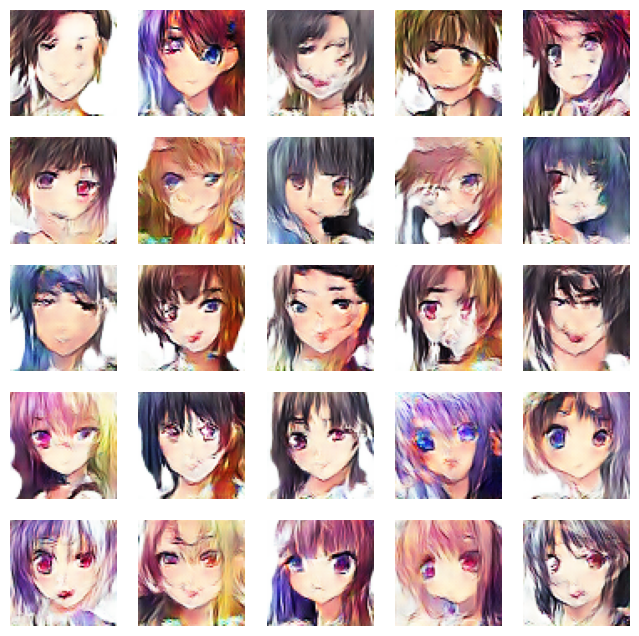

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6538 - g_loss: 1.0736
Epoch 18/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6597 - g_loss: 1.0322

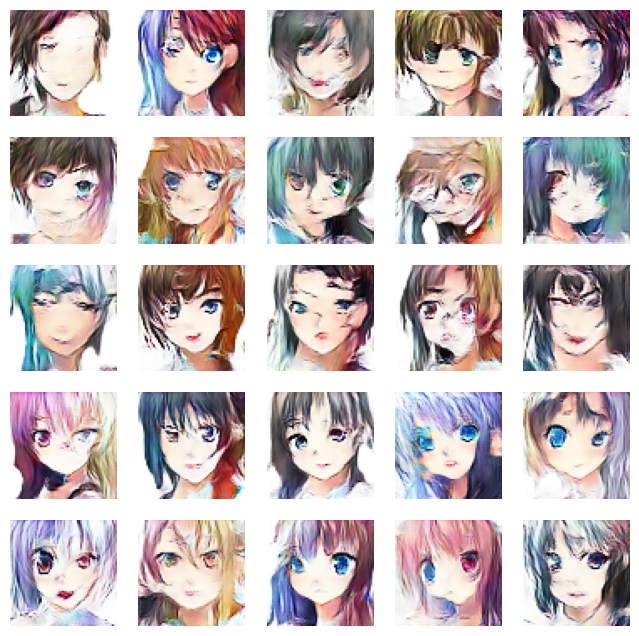

674/674 [==============================] - 44s 66ms/step - d_loss: 0.6598 - g_loss: 1.0322
Epoch 19/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6635 - g_loss: 1.0077

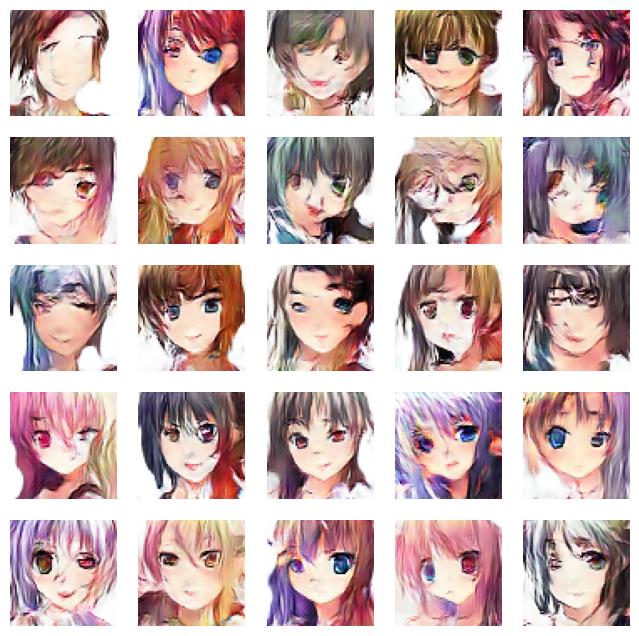

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6636 - g_loss: 1.0072
Epoch 20/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6638 - g_loss: 1.0034

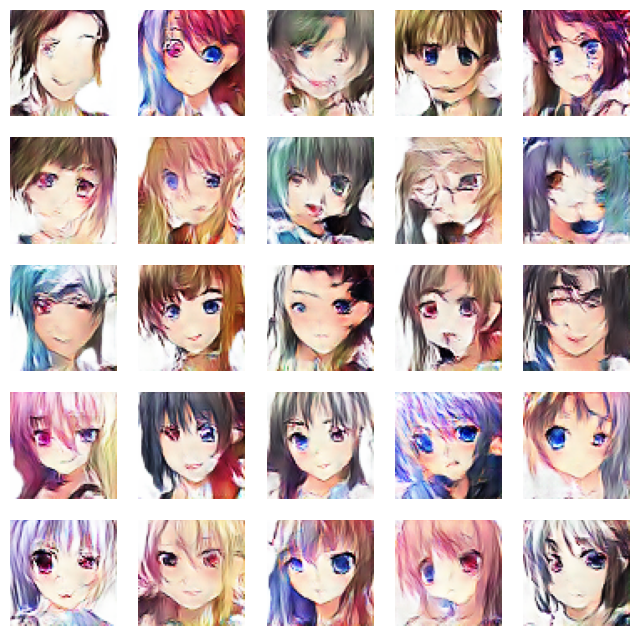

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6637 - g_loss: 1.0032
Epoch 21/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6684 - g_loss: 0.9776

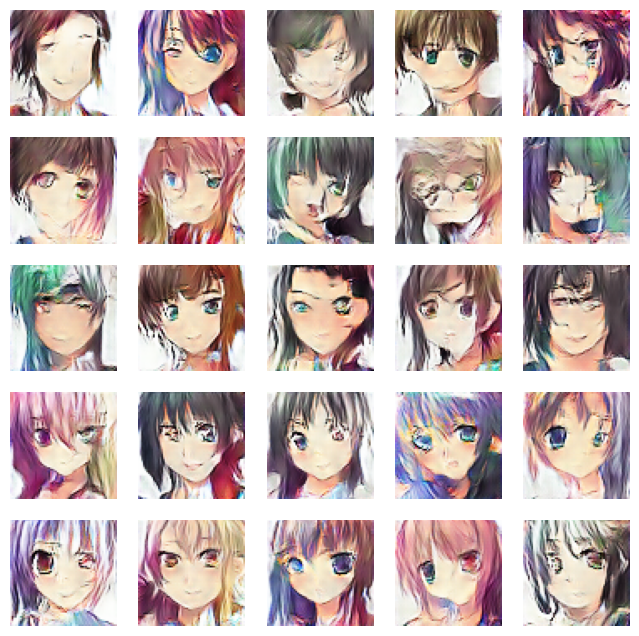

674/674 [==============================] - 44s 66ms/step - d_loss: 0.6682 - g_loss: 0.9782
Epoch 22/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6729 - g_loss: 0.9582

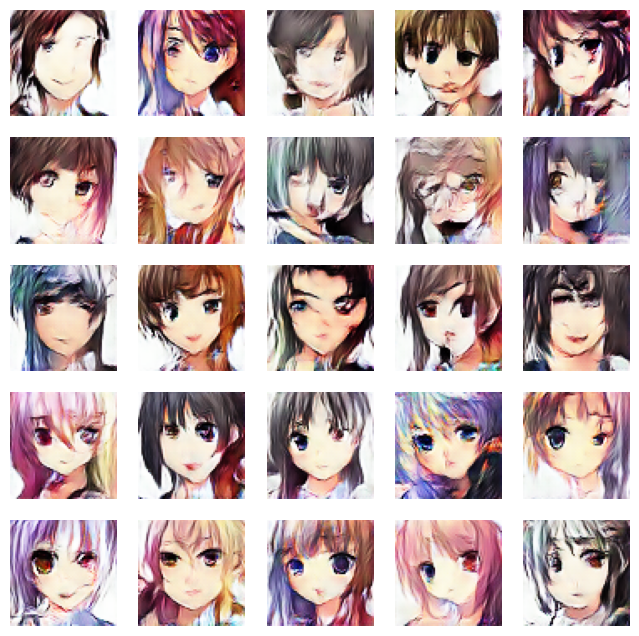

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6729 - g_loss: 0.9581
Epoch 23/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6708 - g_loss: 0.9502

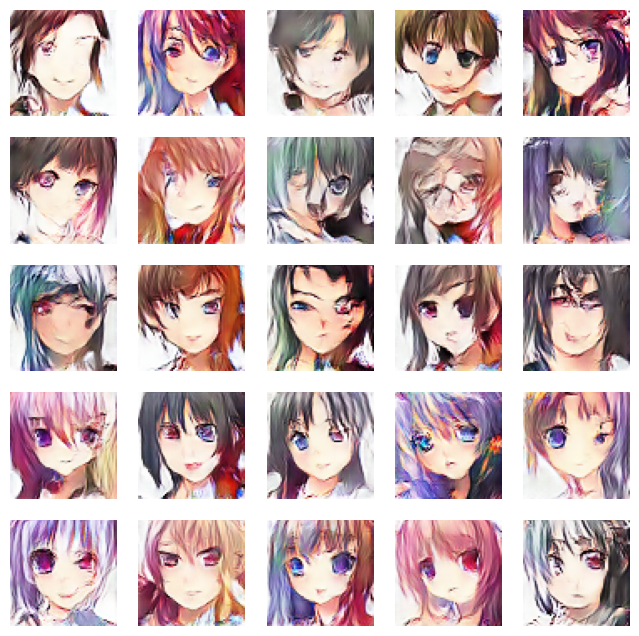

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6707 - g_loss: 0.9507
Epoch 24/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6658 - g_loss: 0.9437

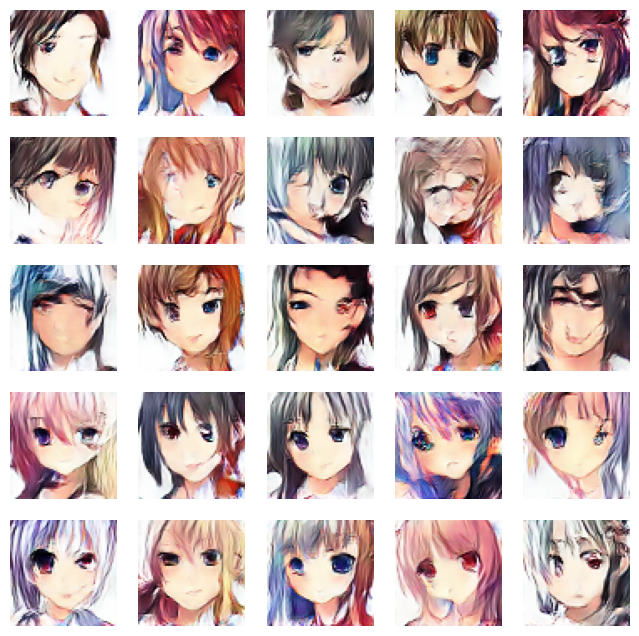

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6657 - g_loss: 0.9436
Epoch 25/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6648 - g_loss: 0.9507

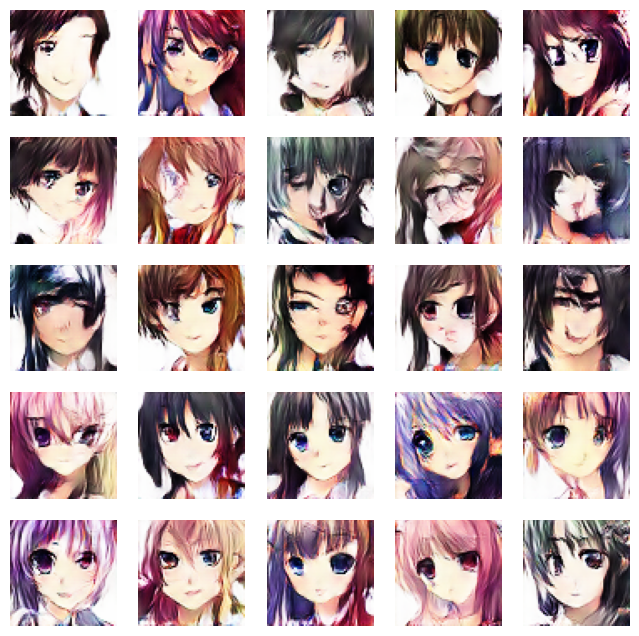

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6650 - g_loss: 0.9508
Epoch 26/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6609 - g_loss: 0.9462

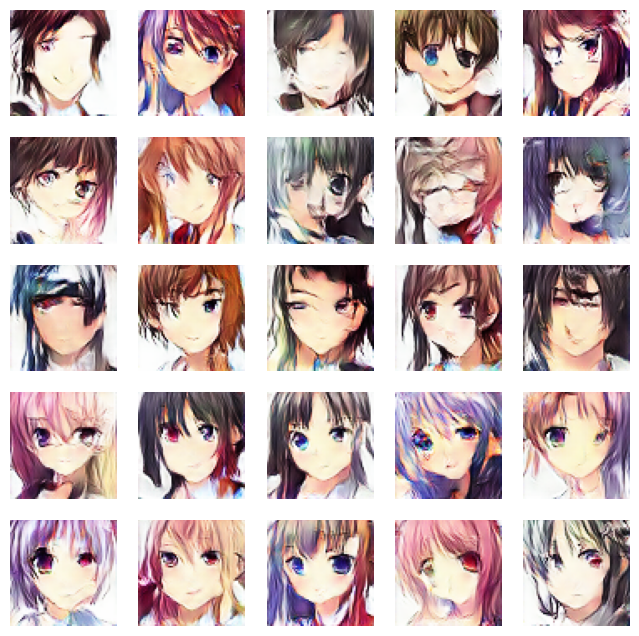

674/674 [==============================] - 44s 66ms/step - d_loss: 0.6610 - g_loss: 0.9463
Epoch 27/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6570 - g_loss: 0.9514

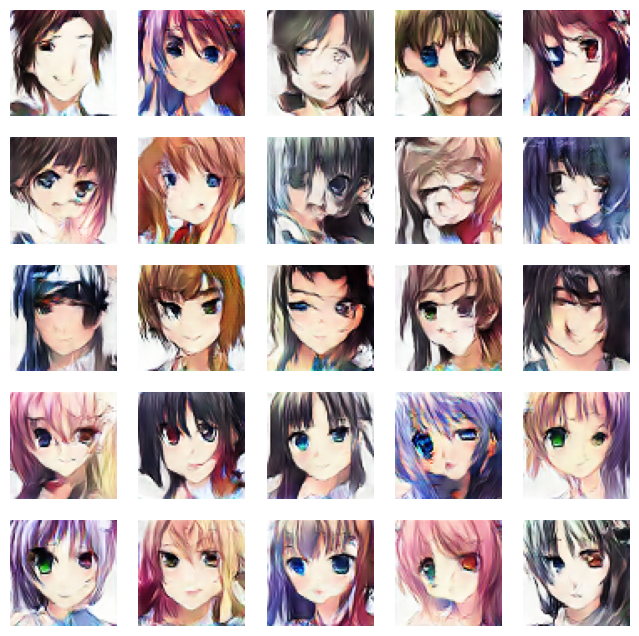

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6572 - g_loss: 0.9512
Epoch 28/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6518 - g_loss: 0.9555

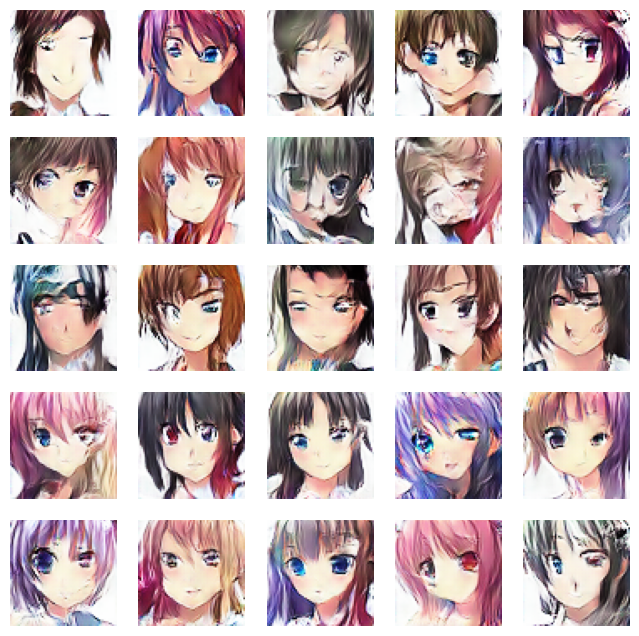

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6518 - g_loss: 0.9560
Epoch 29/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6504 - g_loss: 0.9640

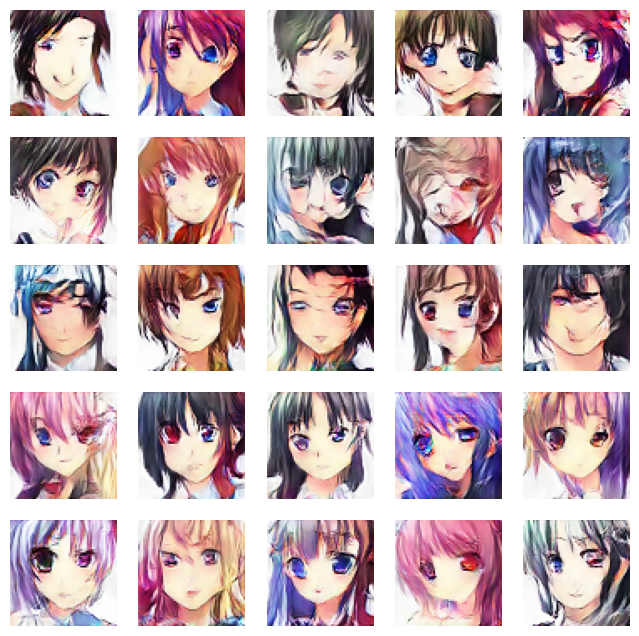

674/674 [==============================] - 44s 66ms/step - d_loss: 0.6503 - g_loss: 0.9643
Epoch 30/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6457 - g_loss: 0.9758

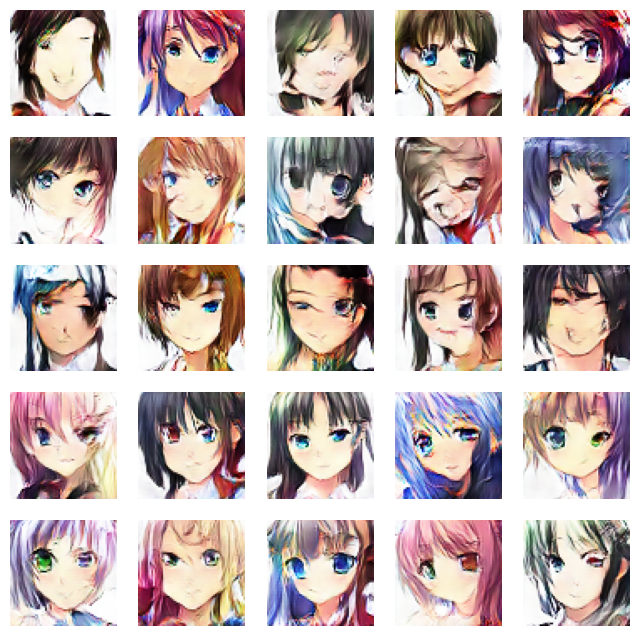

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6456 - g_loss: 0.9757
Epoch 31/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6415 - g_loss: 0.9822

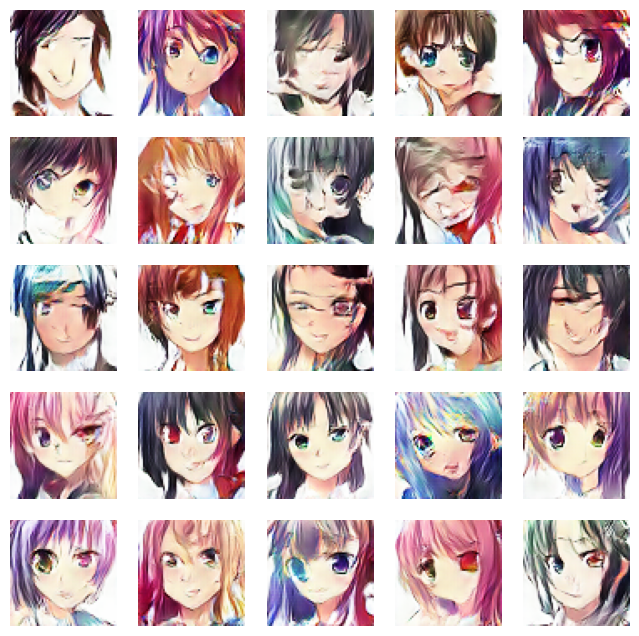

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6413 - g_loss: 0.9817
Epoch 32/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6339 - g_loss: 0.9873

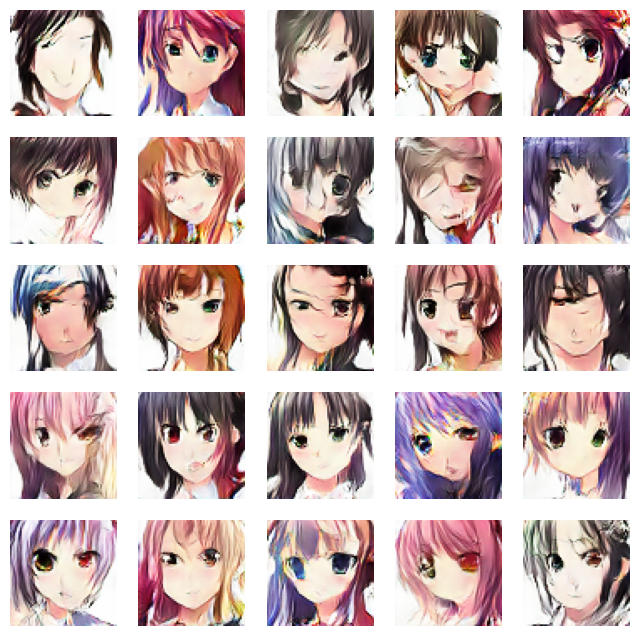

674/674 [==============================] - 44s 66ms/step - d_loss: 0.6339 - g_loss: 0.9873
Epoch 33/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6305 - g_loss: 1.0119

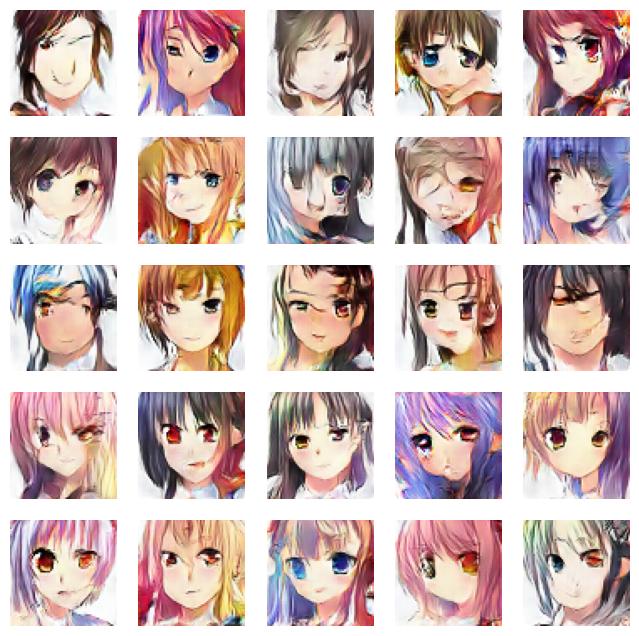

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6304 - g_loss: 1.0121
Epoch 34/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6274 - g_loss: 1.0097

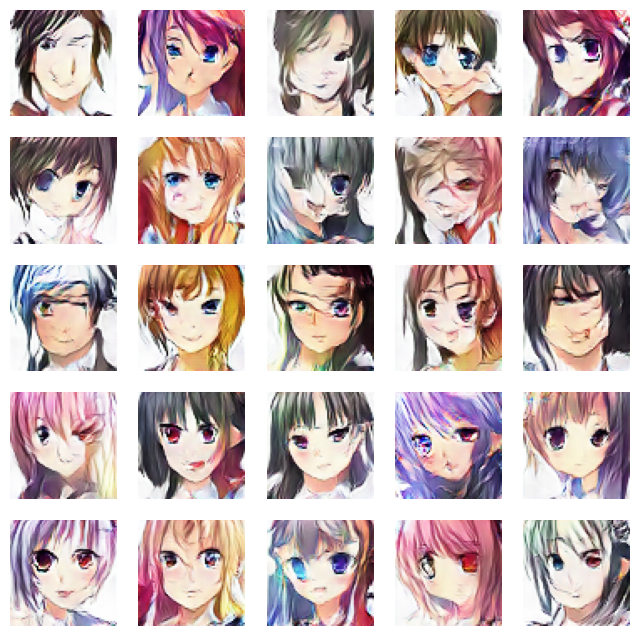

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6273 - g_loss: 1.0096
Epoch 35/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6210 - g_loss: 1.0322

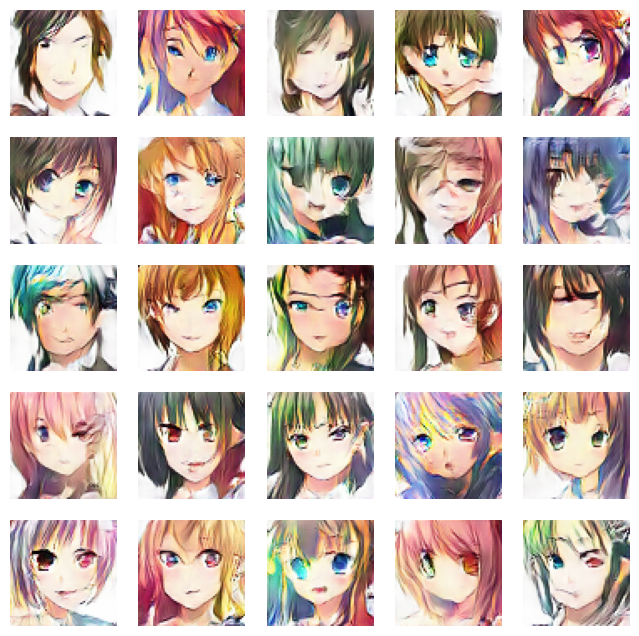

674/674 [==============================] - 44s 66ms/step - d_loss: 0.6211 - g_loss: 1.0320
Epoch 36/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6136 - g_loss: 1.0555

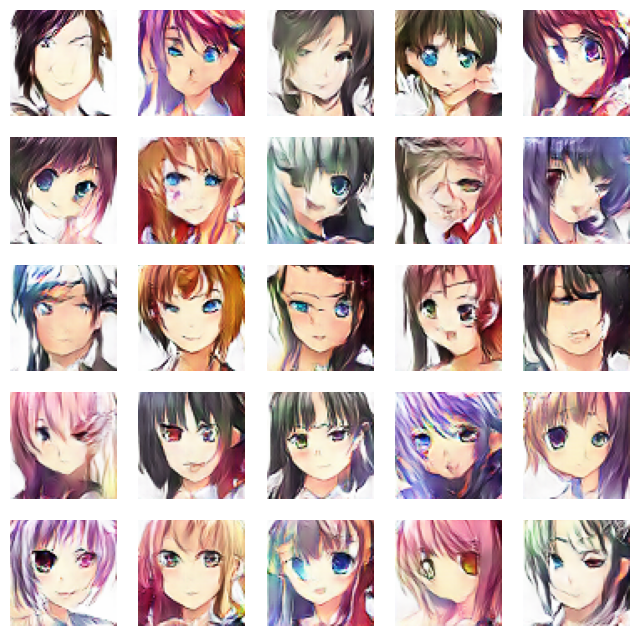

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6136 - g_loss: 1.0556
Epoch 37/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6133 - g_loss: 1.0629

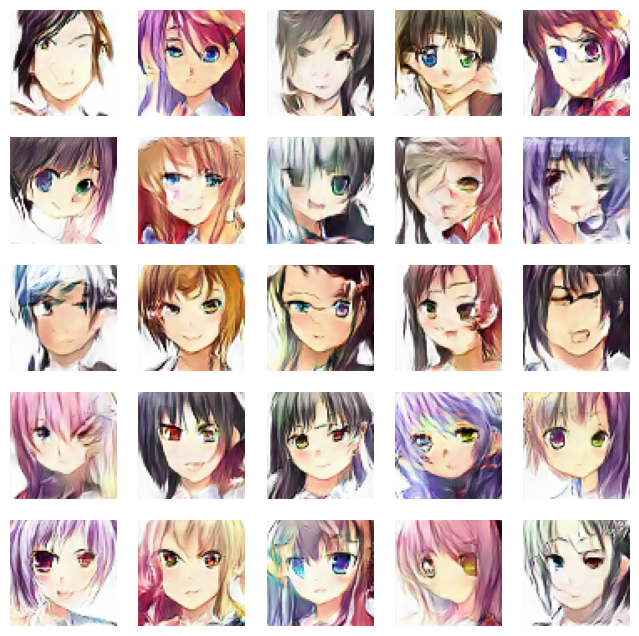

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6132 - g_loss: 1.0633
Epoch 38/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6041 - g_loss: 1.0780

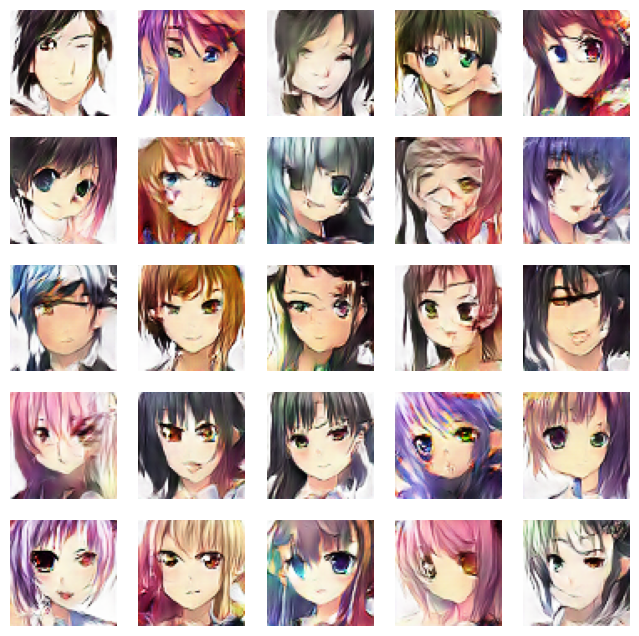

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6040 - g_loss: 1.0780
Epoch 39/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.6026 - g_loss: 1.0921

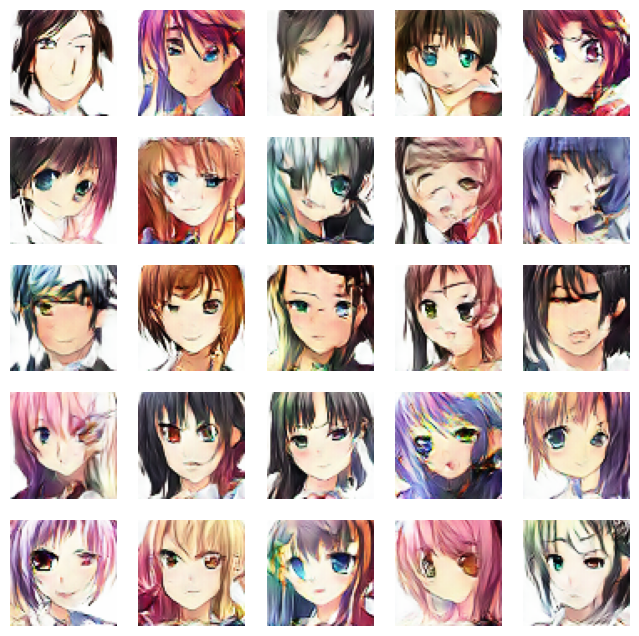

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6025 - g_loss: 1.0925
Epoch 40/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5955 - g_loss: 1.0969

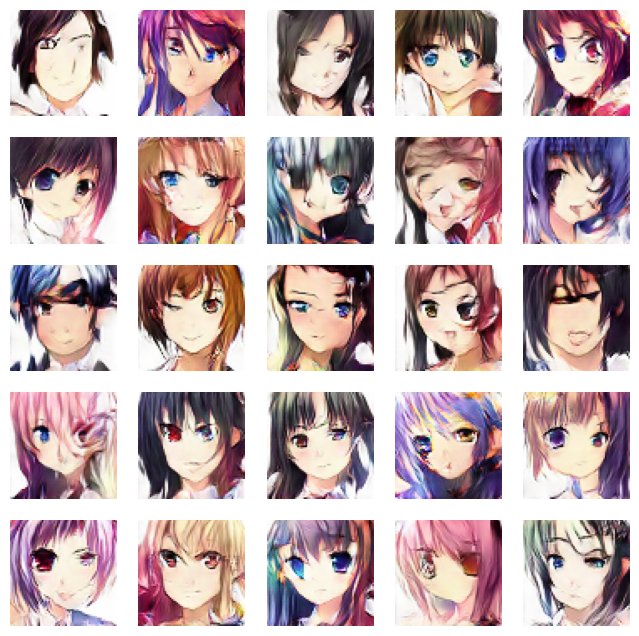

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5956 - g_loss: 1.0968
Epoch 41/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5926 - g_loss: 1.1152

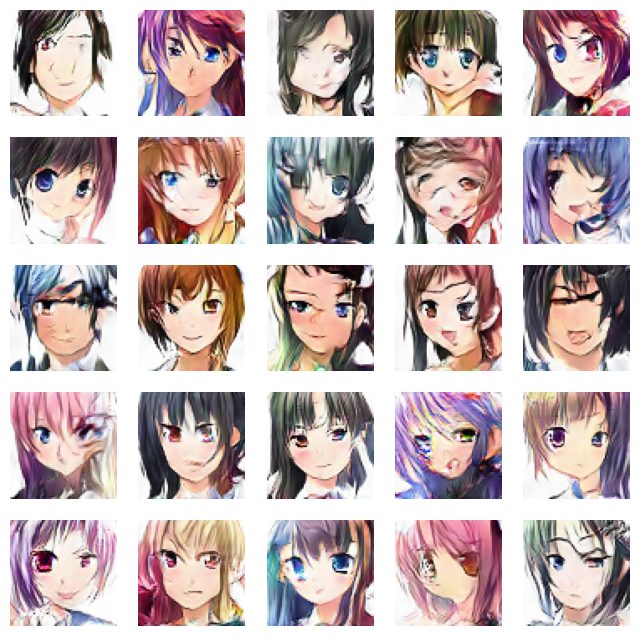

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5927 - g_loss: 1.1151
Epoch 42/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5830 - g_loss: 1.1358

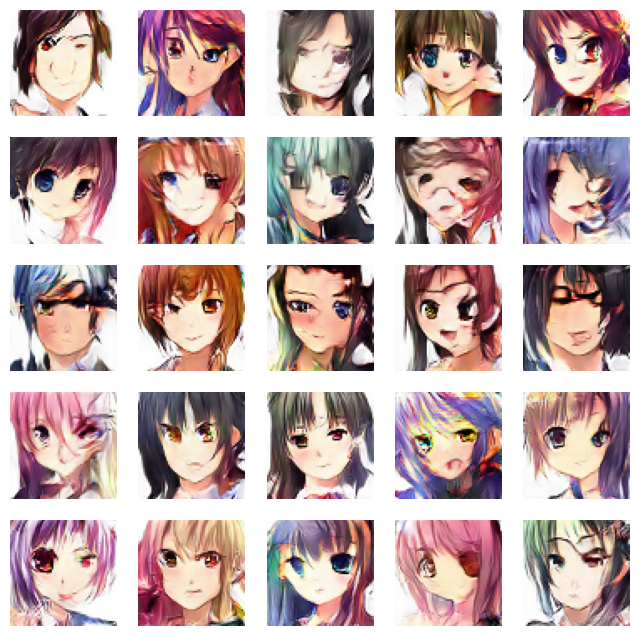

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5829 - g_loss: 1.1361
Epoch 43/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5822 - g_loss: 1.1578

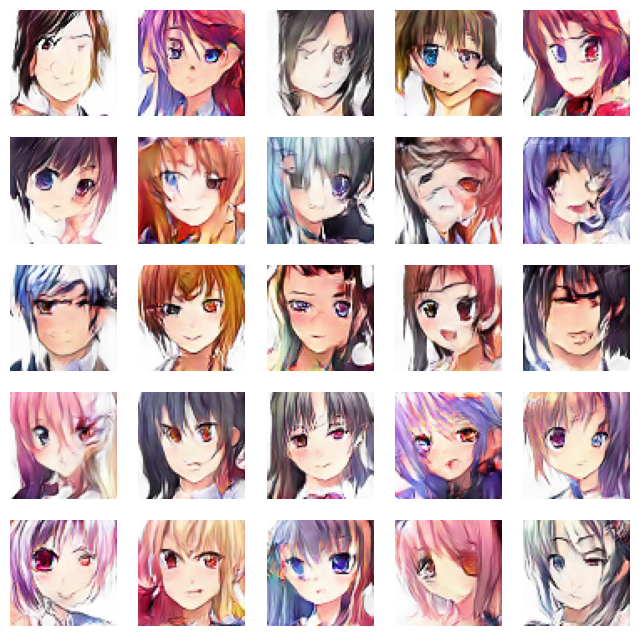

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5823 - g_loss: 1.1577
Epoch 44/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5769 - g_loss: 1.1580

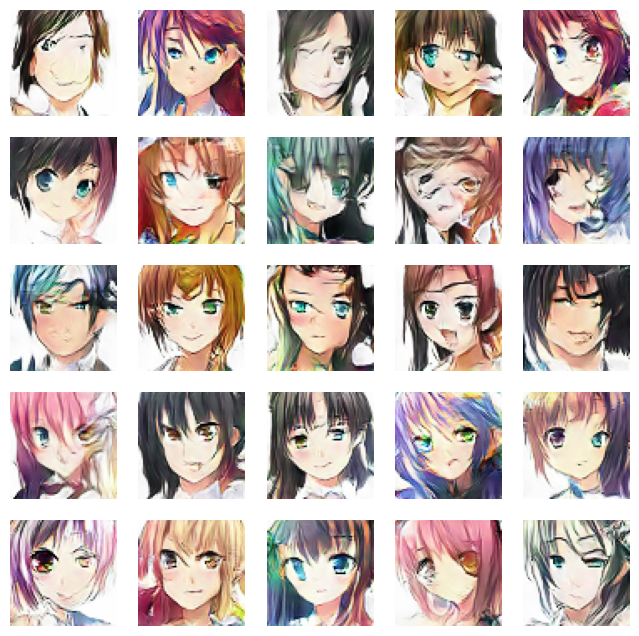

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5770 - g_loss: 1.1579
Epoch 45/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5725 - g_loss: 1.1850

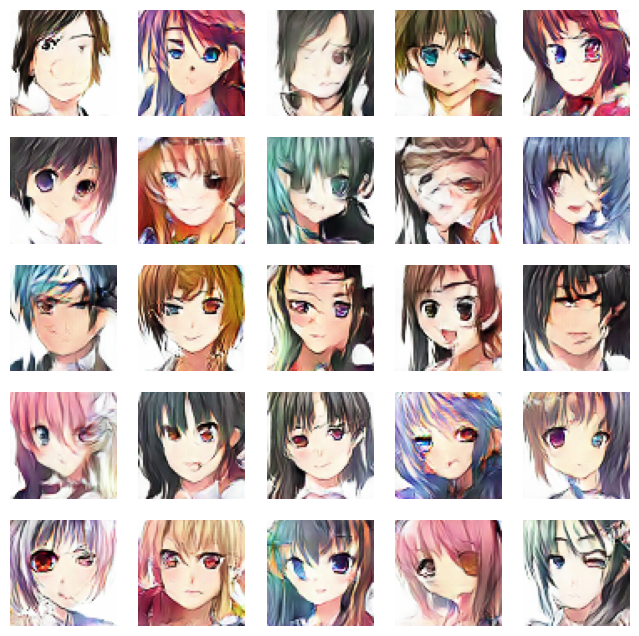

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5727 - g_loss: 1.1849
Epoch 46/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5679 - g_loss: 1.1908

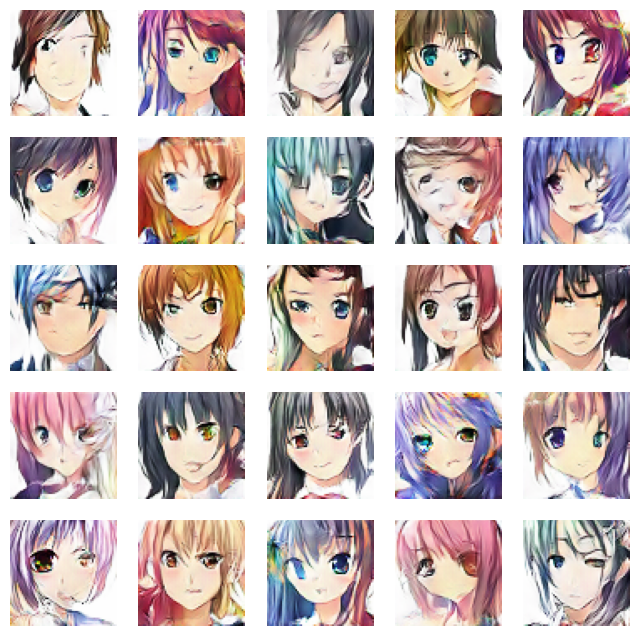

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5679 - g_loss: 1.1910
Epoch 47/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5594 - g_loss: 1.2216

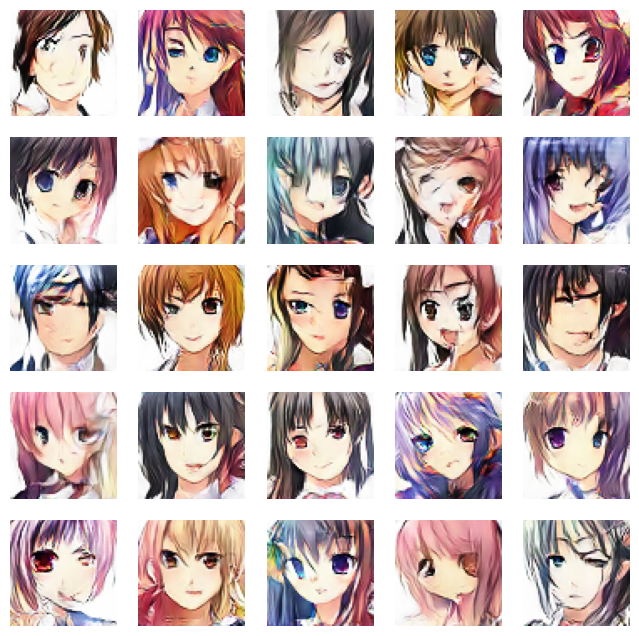

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5594 - g_loss: 1.2220
Epoch 48/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5546 - g_loss: 1.2407

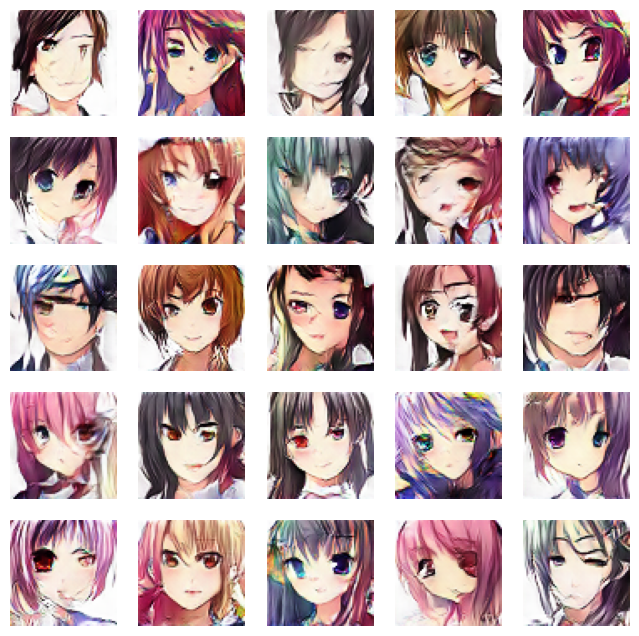

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5547 - g_loss: 1.2420
Epoch 49/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5491 - g_loss: 1.2680

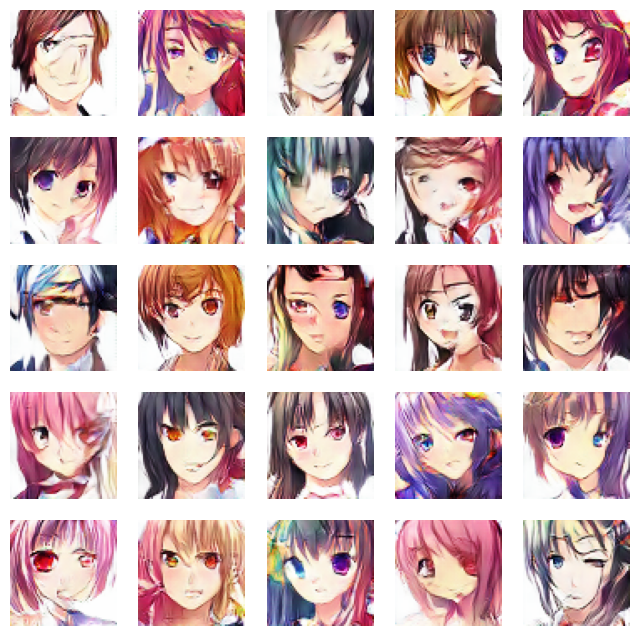

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5493 - g_loss: 1.2674
Epoch 50/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.5513 - g_loss: 1.2719

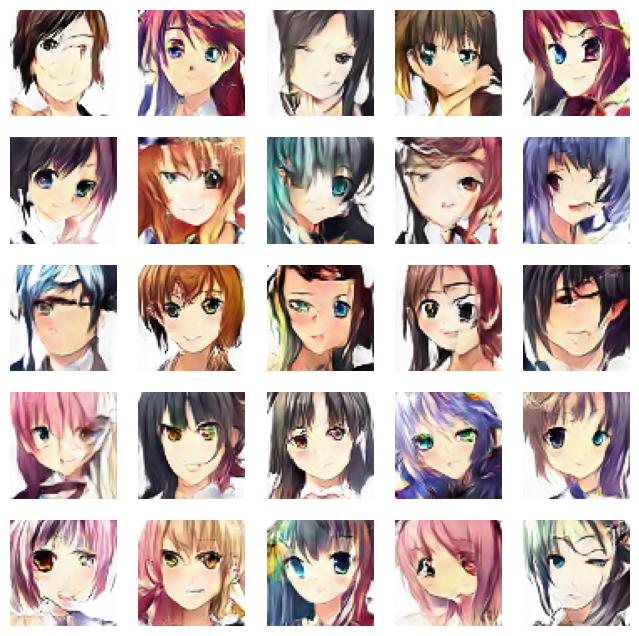

674/674 [==============================] - 44s 65ms/step - d_loss: 0.5512 - g_loss: 1.2713


In [ ]:
N_EPOCHS = 50
dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

## Generate New Anime Image

In [ ]:
from google.colab import files
uploaded = files.upload()

Saving img1.jpeg to img1.jpeg


In [ ]:
# Load the saved DCGAN model
loaded_dcgan = tf.keras.models.load_model("dcgan.h5")

In [ ]:
# Load the saved DCGAN model
loaded_dcgan = tf.keras.models.load_model("dcgan.h5")

# Compile the loaded DCGAN model manually with custom optimizers and loss function
D_LR = 0.0001
G_LR = 0.0003
g_optimizer = tf.keras.optimizers.Adam(learning_rate=G_LR, beta_1=0.5)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=D_LR, beta_1=0.5)
loss_fn = tf.keras.losses.BinaryCrossentropy()

loaded_dcgan.compile(
    optimizer=g_optimizer,  # Use your custom generator optimizer here
    loss=loss_fn,           # Use your custom loss function here
    metrics=["accuracy"]    # You can add custom metrics if needed
)

In [ ]:
file_path = '/content/img1.jpeg'

In [ ]:
input_image = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)
display(input_image)

array([[201, 201, 201, ..., 191, 191, 191],
       [201, 201, 201, ..., 191, 191, 191],
       [201, 201, 201, ..., 191, 191, 191],
       ...,
       [190, 190, 190, ..., 188, 188, 188],
       [190, 190, 190, ..., 188, 188, 188],
       [190, 190, 190, ..., 188, 188, 188]], dtype=uint8)

In [ ]:
import cv2
import tensorflow as tf
import matplotlib.pyplot as plt
from PIL import Image
from IPython.display import display

# Load and preprocess the input image
input_image = cv2.imread(file_path, cv2.IMREAD_GRAYSCALE)  # Load as grayscale
input_image = cv2.resize(input_image, (10, 10))  # Resize to a smaller size
input_image = input_image.astype('float32') / 255.0  # Normalize pixel values to [0, 1]

# Flatten and reshape the input image to (1, 100) for generator input
input_image = input_image.flatten().reshape((1, 100))

# Use the generator to predict/generate an image based on the input tensor
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = loaded_dcgan.generator(input_image)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img = g_img.numpy()
img = Image.fromarray(g_img[0].astype('uint8'))

# Display the generated image in the Colab notebook
display(img)

AttributeError: ignored

<Figure size 300x300 with 0 Axes>